0.012531328320802006


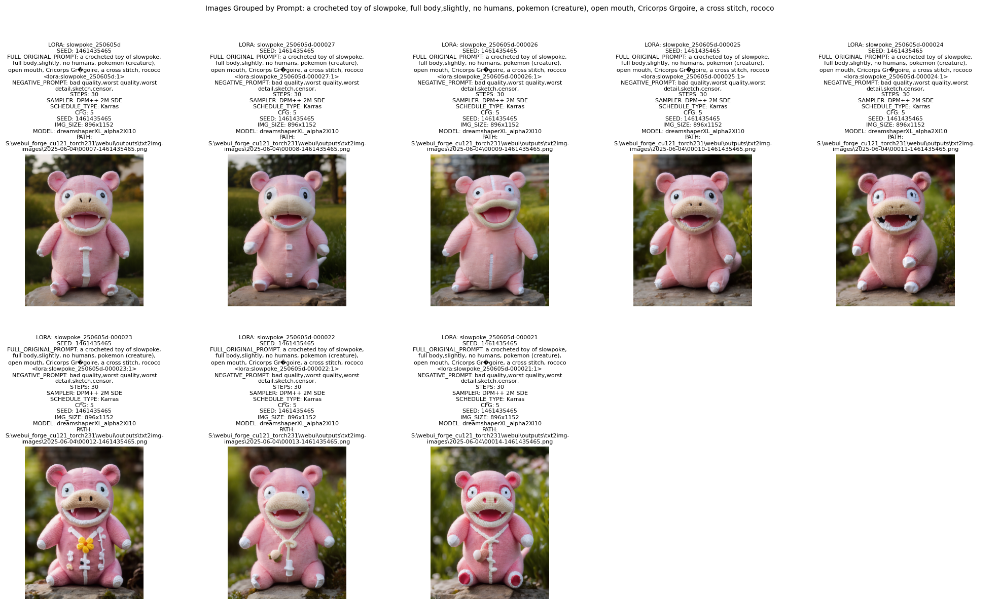

0.012531328320802006


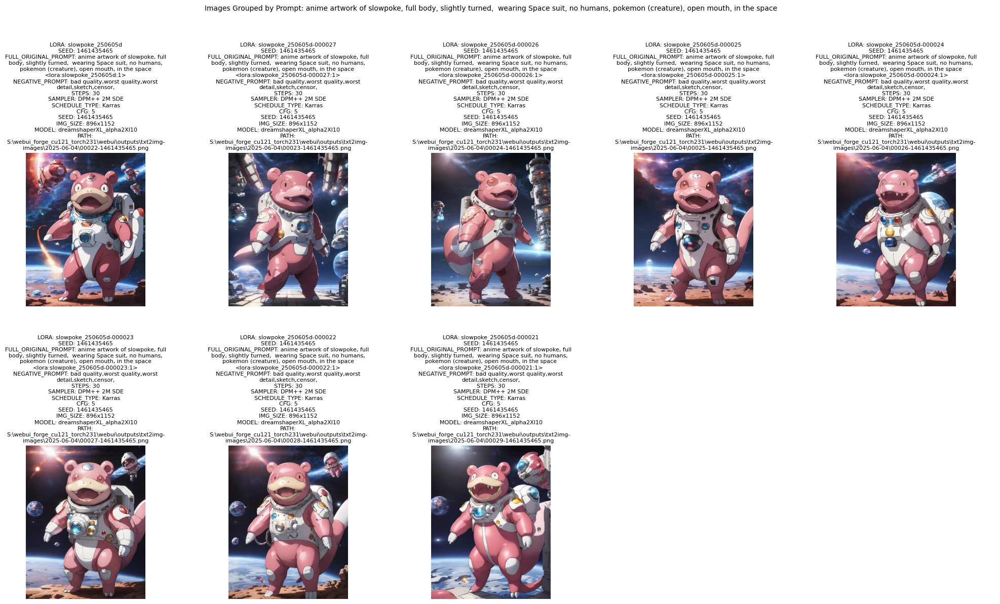

0.012531328320802006


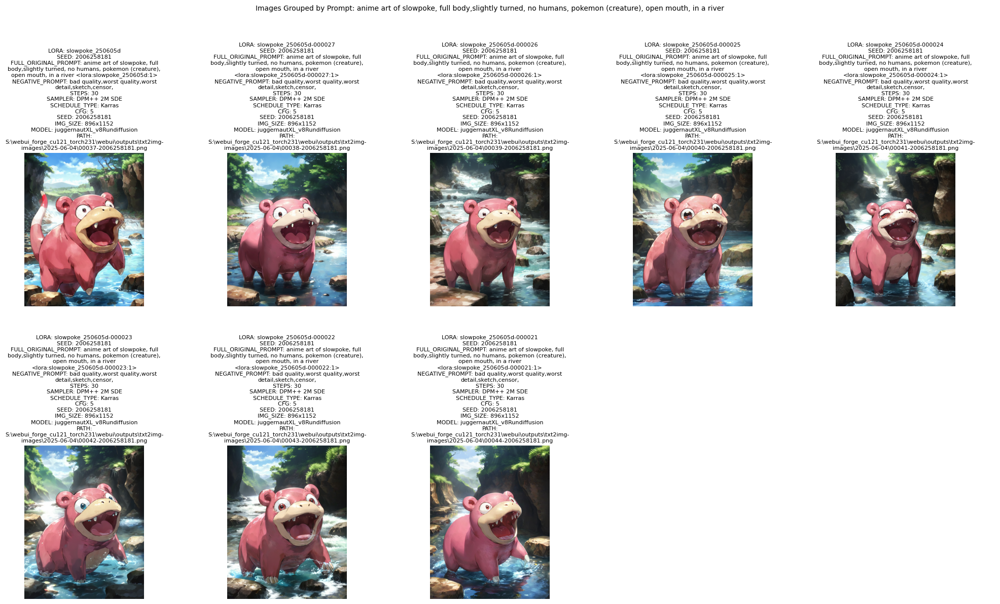

0.012531328320802006


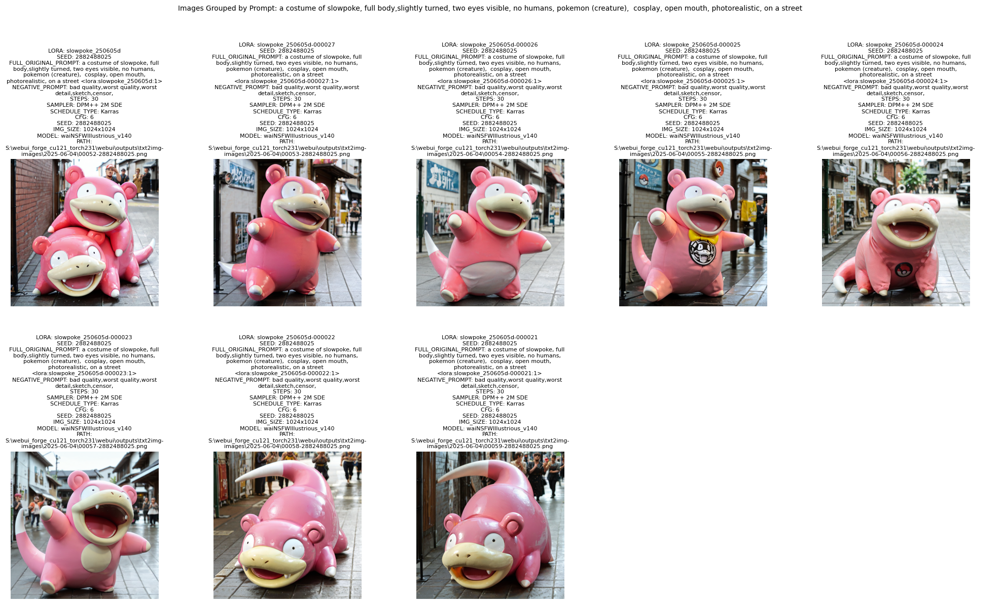

0.012531328320802006


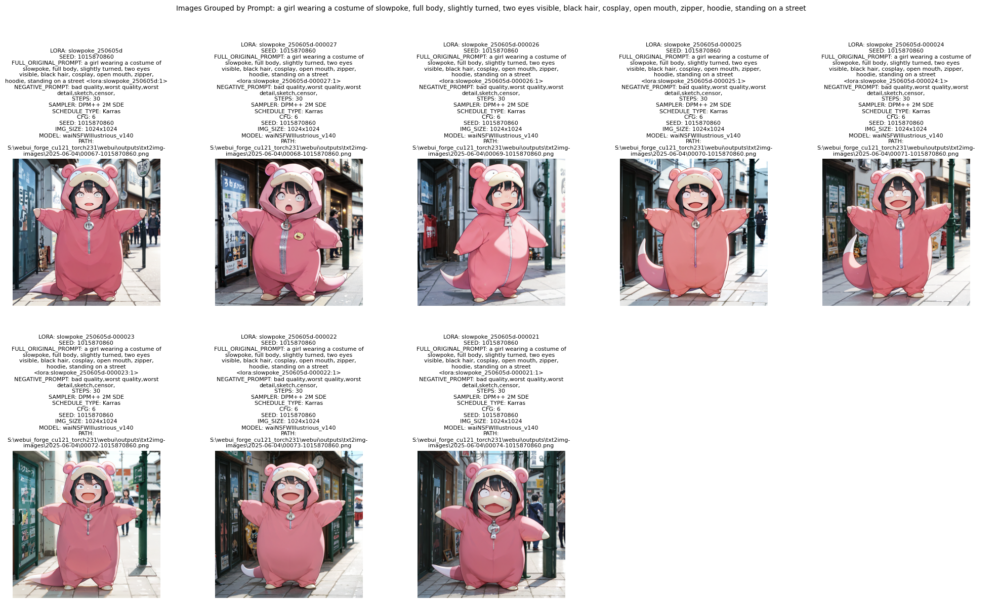

0.012531328320802006


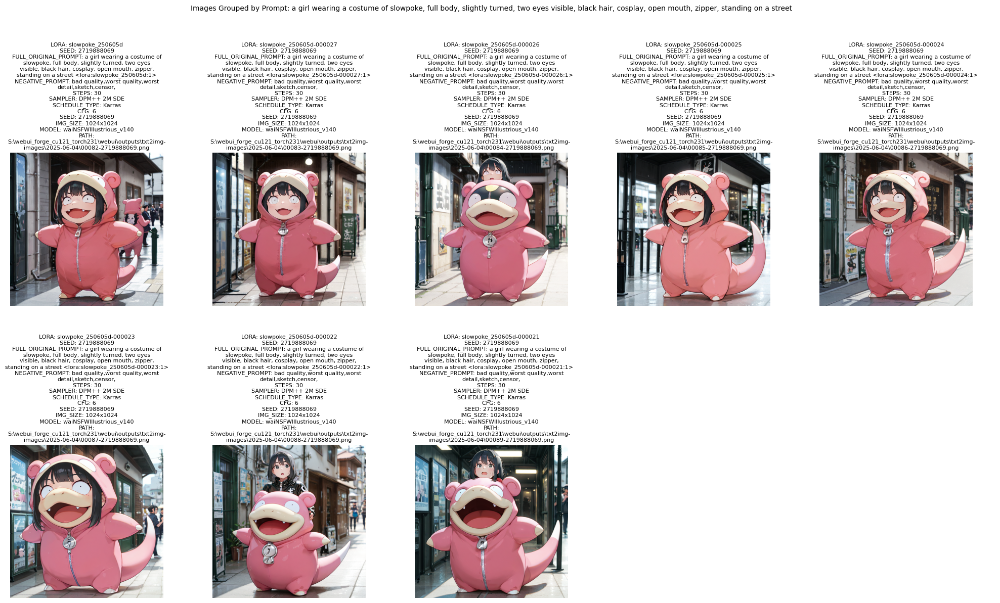

0.012531328320802006


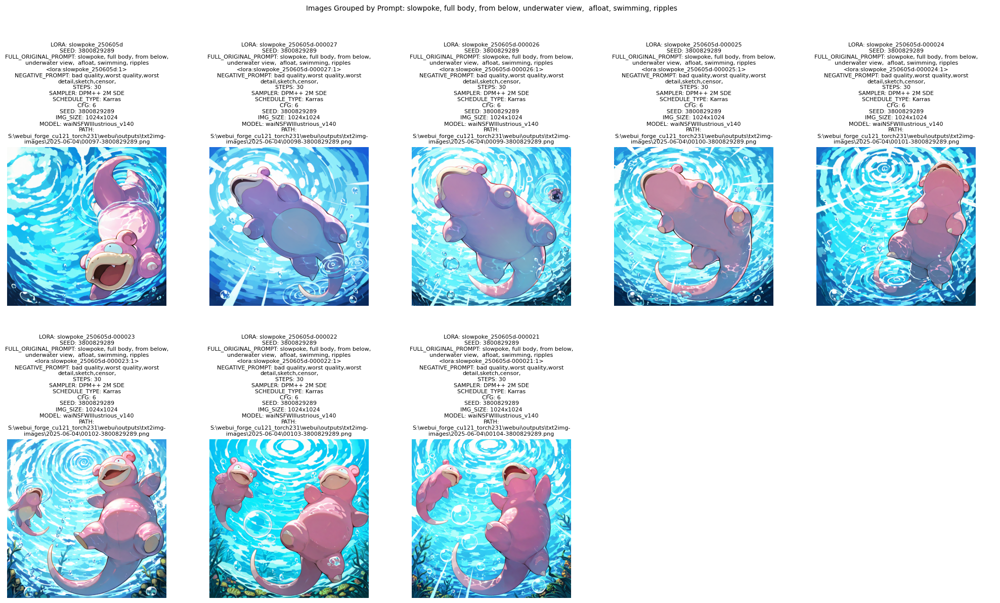

0.012531328320802006


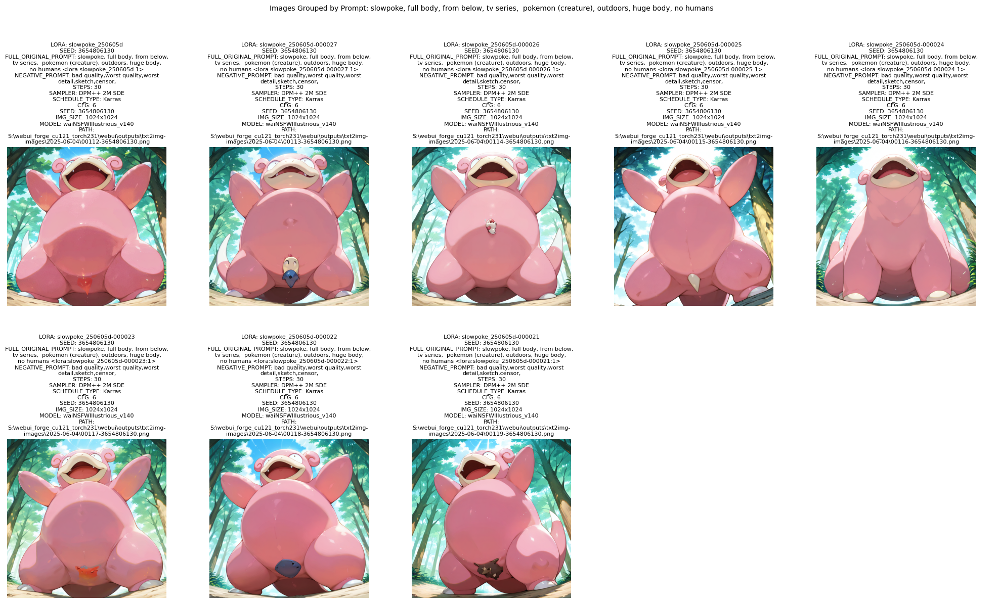

0.012531328320802006


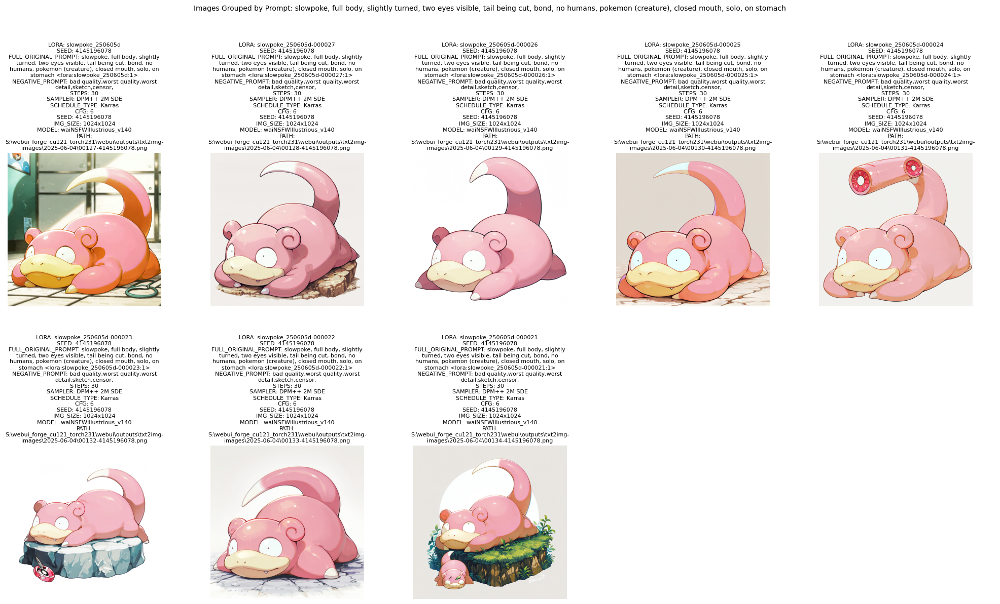

0.012531328320802006


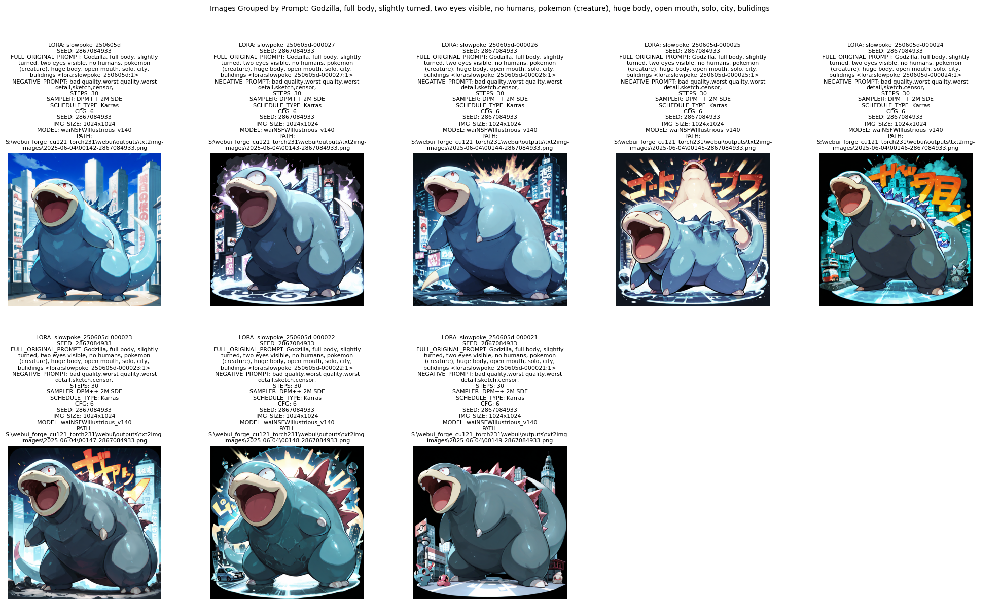

0.012531328320802006


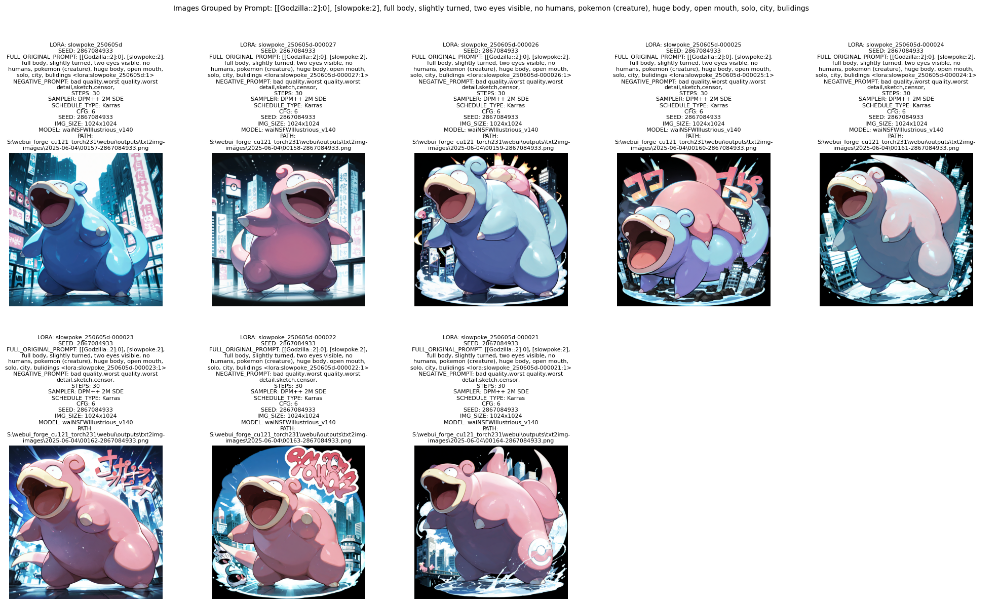

KeyboardInterrupt: 

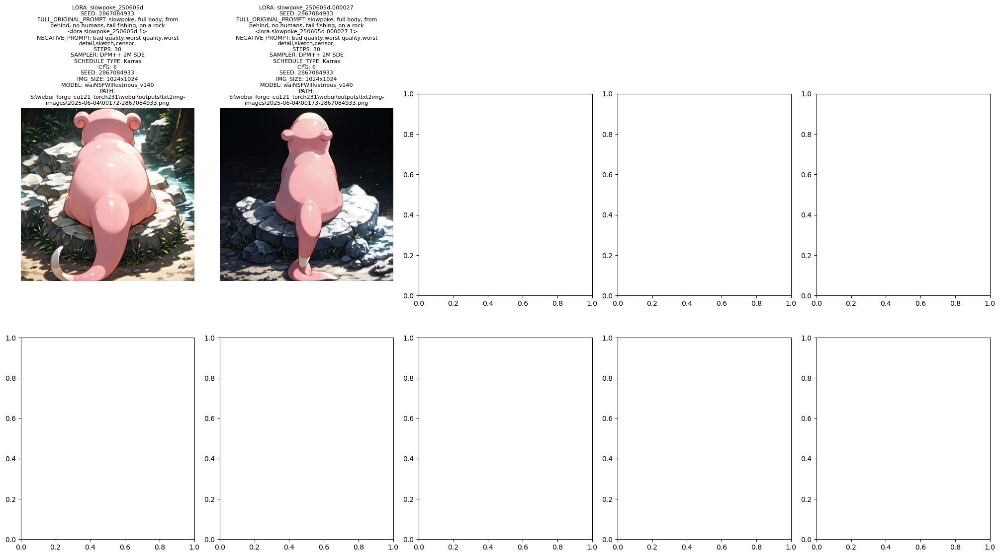

In [69]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import defaultdict
import math
import re
import textwrap
from metadata_utils import extract_metadata

# Configuration parameters
base_lora = 'slowpoke_250605d'
lora_list = [f'{base_lora}-0000{i:02}' for i in range(21, 28)] + [base_lora]
image_folder_list = [r'S:\webui_forge_cu121_torch231\webui\outputs\txt2img-images\2025-06-04']

#plot settings
IMAGE_SIZE = (4, 4)  # (width, height) in inches for each image
COLUMNS = 5  # Number of columns in the grid

#main title settings
MAIN_TITLE_FONT_SIZE = 10
MAIN_TITLE_y_POS = 1.05 #basic position of the main title (value 0~1 within subplot height)

#subplot settings
FONT_SIZE = 8  # Font size for titles
DPI = 100  # Resolution for rendering (dots per inch)
SUBPLOT_SPACING_w = 0  # Spacing between subplots (horizontal)
SUBPLOT_SPACING_w = 0.1 # (vertical)
TITLE_PAD = 15  # Padding for subplot titles
TITLE_PARAM = ('lora', 'seed', 'full_original_prompt', 'negative_prompt', 'steps',
    'sampler', 'schedule_type', 'cfg', 'seed', 'img_size', 'model', 'path')

# Valid metadata fields for TITLE_PARAMS
VALID_TITLE_PARAMS = (
    'image', 'lora', 'full_original_prompt', 'negative_prompt', 'steps',
    'sampler', 'schedule_type', 'cfg', 'seed', 'img_size', 'model', 'path'
)

# Helper functions
def prompt_symbol_replace(prompt):
    """Replace special characters in prompts with a placeholder."""
    return re.sub(r'<.*?>', '�', prompt).strip()

def convert_prompt_wo_lora(prompt_symbol):
    """Remove placeholder characters from prompts."""
    return prompt_symbol.replace('�', '').strip()

def setup_title(image_info, title_parameters):
    """Generate subplot title from specified metadata parameters."""
    return '\n'.join([f"{param.upper()}: {image_info[param]}" for param in title_parameters])
    
#TITLE EXAMPLE:
# title = (f"Lora: {image_info['lora']}\n"
#          f"Seed: {image_info['seed']}\n"
#          f"CFG: {image_info['cfg']}\n"
#          f"Steps: {image_info['steps']}\n"
#          f"Sampler: {image_info['sampler']}\n"
#          f"Model: {image_info['model']}\n"
#          f"Size: {image_info['img_size']}\n"
#          f"image: {image_info['image']}")


def collect_images():
    """Collect image metadata for specified LoRA models from given folders."""
    image_to_plot_list = []
    for image_folder in image_folder_list:
        if not os.path.exists(image_folder):
            print(f"Warning: Folder {image_folder} does not exist")
            continue
        for filename in os.listdir(image_folder):
            if filename.endswith(".png"):
                image_path = os.path.join(image_folder, filename)
                metadata = extract_metadata(image_path)
                
                lora = str(metadata.get('Lora hashes', '')).strip('"').split(':')[0]
                if lora in lora_list:
                    image_info = {
                        'image': filename,
                        'lora': lora,
                        'full_original_prompt': metadata.get('prompt', ''),
                        'negative_prompt': metadata.get('negative_prompt', ''),
                        'steps': metadata.get('Steps', ''),
                        'sampler': metadata.get('Sampler', ''),
                        'schedule_type': metadata.get('Schedule type', ''),
                        'cfg': metadata.get('CFG scale', ''),
                        'seed': metadata.get('Seed', ''),
                        'img_size': metadata.get('Size', ''),
                        'model': metadata.get('Model', ''),
                        'path': image_path
                    }
                    image_to_plot_list.append(image_info)
    return image_to_plot_list

def plot_images(image_to_plot_list, group_by='prompt'):
    """Plot images grouped by specified parameter with dynamic title sizing."""
    # Validate group_by parameter
    if group_by not in ['prompt', 'seed']:
        raise ValueError("group_by must be 'prompt' or 'seed'")

    # Validate TITLE_PARAMS
    invalid_params = [p for p in TITLE_PARAMS if p not in VALID_TITLE_PARAMS]
    if invalid_params:
        raise ValueError(f"Invalid TITLE_PARAMS: {invalid_params}")
        
    # Group images by specified parameter
    grouped_images = defaultdict(list)
    for image_info in image_to_plot_list:
        if group_by == 'prompt':
            key = convert_prompt_wo_lora(prompt_symbol_replace(image_info['full_original_prompt']))
        elif group_by == 'seed':
            key = image_info['seed']
        else:
            raise ValueError("group_by must be 'prompt' or 'seed'")
        grouped_images[key].append(image_info)
    
    # Set DPI to control image size in pixels
    IMAGE_PIXEL_SIZE = IMAGE_SIZE[0] * 100  # Desired image size in pixels (width and height)
    IMAGE_SIZE_INCHES = IMAGE_PIXEL_SIZE / DPI  # Convert to inches for figure size
    
    # Estimate subplot title height (in inches) per line
    title_line_height = FONT_SIZE / 72.0  # Approximate height per line (72 points per inch)
    max_title_lines = len(TITLE_PARAM)  # Maximum number of lines in a subplot title
    title_height = title_line_height * max_title_lines + TITLE_PAD/72  # Add padding(TITLE_PAD/72= ~0.2) for title

    for group_key, images in grouped_images.items():
        num_images = len(images)
        num_rows = math.ceil(num_images / COLUMNS)

        # Calculate figure size: image size + title height,  dynamically (overall subplot area)
        fig_width = COLUMNS * IMAGE_SIZE[0]
        fig_height = num_rows * (IMAGE_SIZE[1] + title_height)

        # Create figure with constrained layout
        fig, axes = plt.subplots(num_rows, COLUMNS, 
                                 figsize=(fig_width, fig_height), 
                                 layout="constrained", 
                                 dpi=DPI, #(default: 100.0) The resolution of the figure in dots-per-inch.
                                 gridspec_kw={'wspace': SUBPLOT_SPACING_w, 'hspace': SUBPLOT_SPACING_h})
        
        # Handle single row or column cases
        if num_rows == 1:
            axes = [axes] if COLUMNS == 1 else axes
        else:
            axes = axes.flatten()
            
        # Calculate main title width and wrap
        def cal_suitable_title_length(fig_width, font_size):
            """Calculate maximum characters(approximate) is available for the width"""

            #how many inches(hegith) for each font(approximate):
            font_inch_h = (font_size)/72
            font_inch_w = font_inch_h/1.5 # Approximate character width # adjust this if you want adjust wrapped text length
            max_chars = int(fig_width / font_inch_w)
            return max_chars

        def reconstruct_wrapped_title(title, plot_width):
            """Reconstruct wrapped title"""
            title_lines = title.split('\n')
            wrapped_title_lines = []
            for line in title_lines:
                wrapped_lines = textwrap.wrap(line, width= plot_width)
                wrapped_title_lines += wrapped_lines
            wrapped_title = "\n".join(wrapped_title_lines) #final format
            return wrapped_title
            
        # Plot images
        for i, image_info in enumerate(images):
            img_path = image_info['path']
            try:
                img = mpimg.imread(img_path)
                axes[i].imshow(img)
                axes[i].axis('off')
                
                # Set subplot title
                title = setup_title(image_info, TITLE_PARAM)
                
                # Reconstruct wrapped subplot title
                subplot_width = cal_suitable_title_length(IMAGE_SIZE[0], FONT_SIZE)
                subplot_title = reconstruct_wrapped_title(title, subplot_width)
                wrapped_subplot_title_line_count = len(subplot_title.split('\n'))
                
                axes[i].set_title(subplot_title, fontsize=FONT_SIZE, pad=5)
            except Exception as e:
                print(f"Error loading image {img_path}: {e}")
                axes[i].axis('off')
        
        # Turn off unused axes
        for i in range(len(images), len(axes)):
            axes[i].axis('off')
            
        main_title_width = cal_suitable_title_length(fig_width, MAIN_TITLE_FONT_SIZE)
            
        # Wrap main title to avoid excessive width
        main_title = f"Images Grouped by {group_by.title()}: {group_key}"
        wrapped_main_title = reconstruct_wrapped_title(main_title, main_title_width)
        wrapped_main_title_line_count = len(wrapped_main_title.split('\n'))
        
        # Adjust main title position
        def cal_title_y_pos(fig_height, font_size):
            """Adjust y-position dynamically by considering the fraction of main title font height in 
            the overall subplot height"""
            font_inch_h = font_size/72
            title_fraction = font_inch_h/fig_height
            adjust_y = title_fraction
            print(adjust_y)
            return adjust_y
            
        additional_y = cal_title_y_pos(fig_height, MAIN_TITLE_FONT_SIZE) * wrapped_main_title_line_count #Larger font/more lines, higher delta y
            
        fig.suptitle(wrapped_main_title, fontsize=MAIN_TITLE_FONT_SIZE, y= MAIN_TITLE_y_POS + additional_y) #(MAIN_TITLE_y_POS = 1.05)
        
        # Plot
        plt.show()

def main(group_by='prompt'):
    """Main function to collect and plot images."""
    images = collect_images()
    if not images:
        print("No images found matching the criteria")
        return
    plot_images(images, group_by=group_by)

# Run the script
if __name__ == "__main__":
    main(group_by='prompt')
    # To group by seed, uncomment the following line
    # main(group_by='seed')

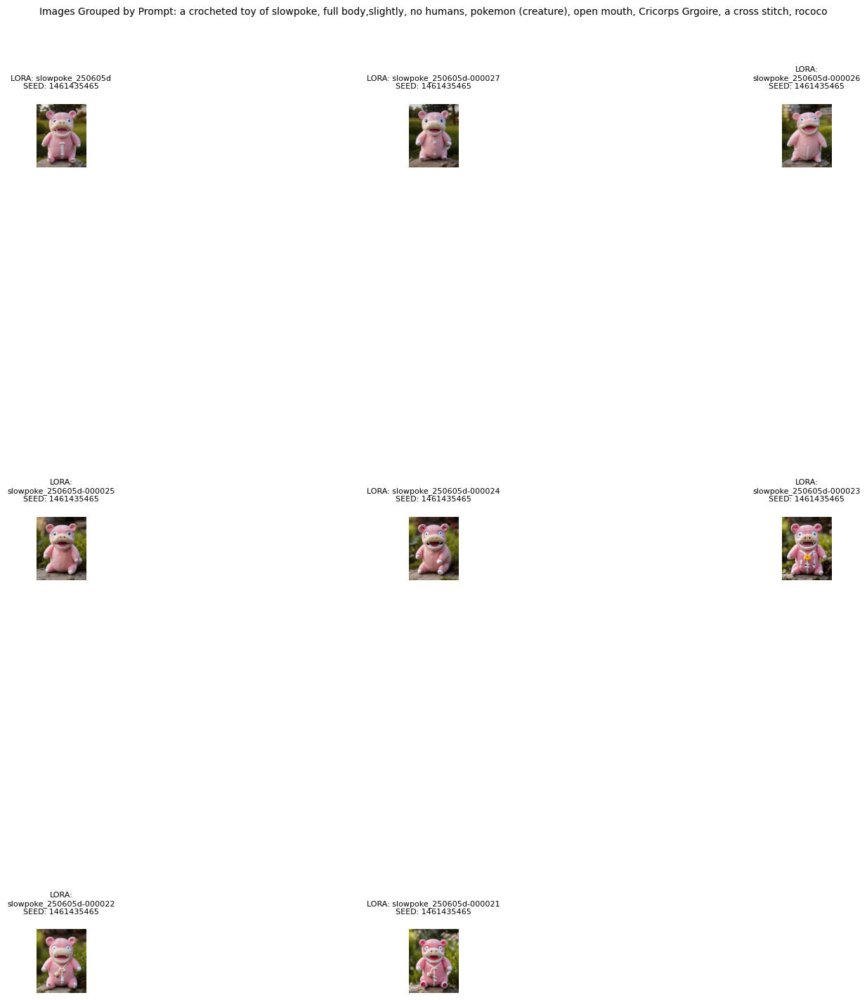

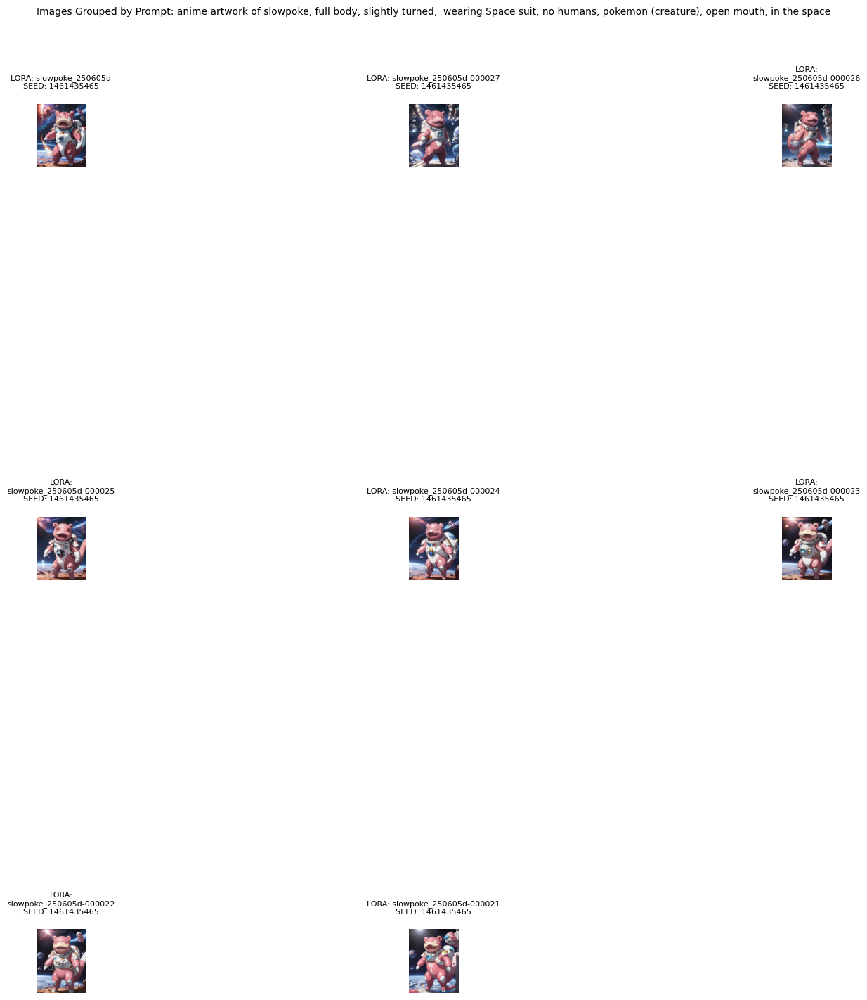

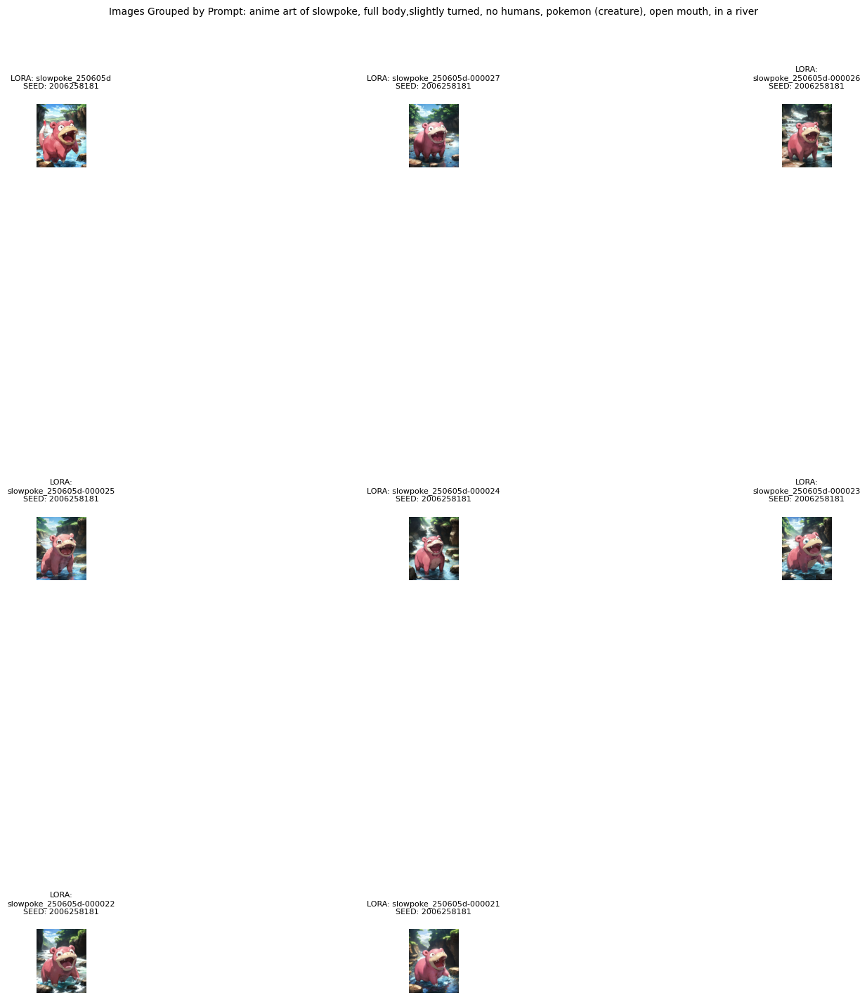

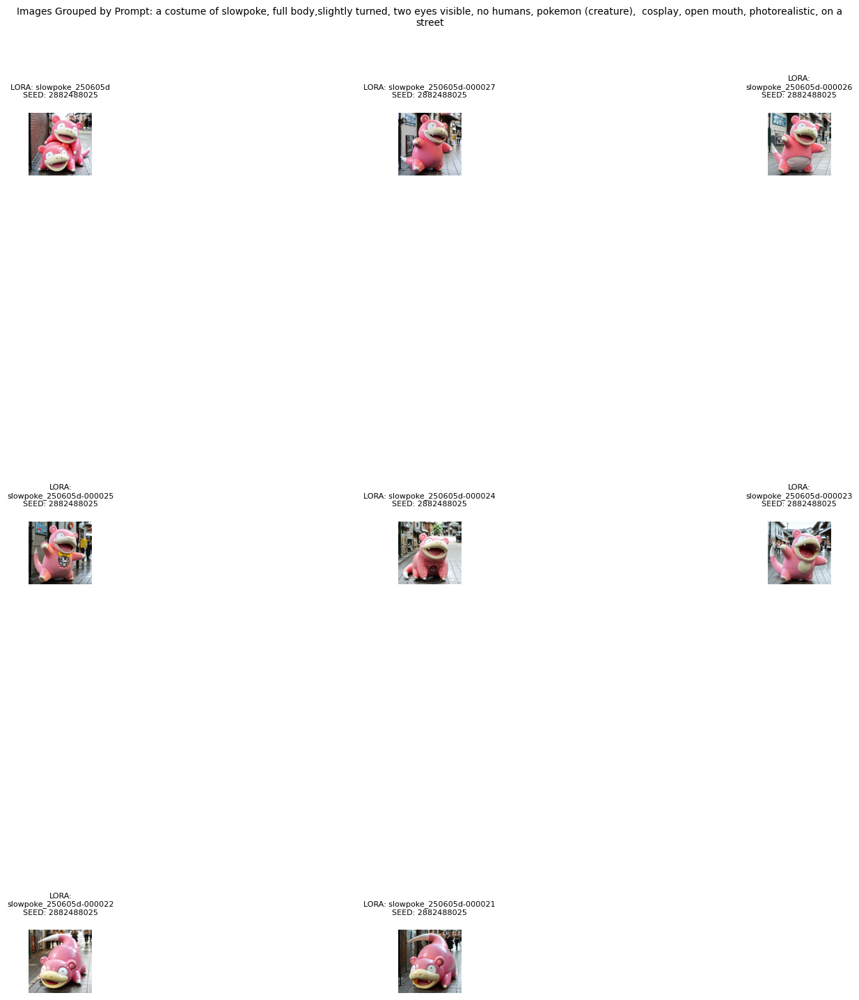

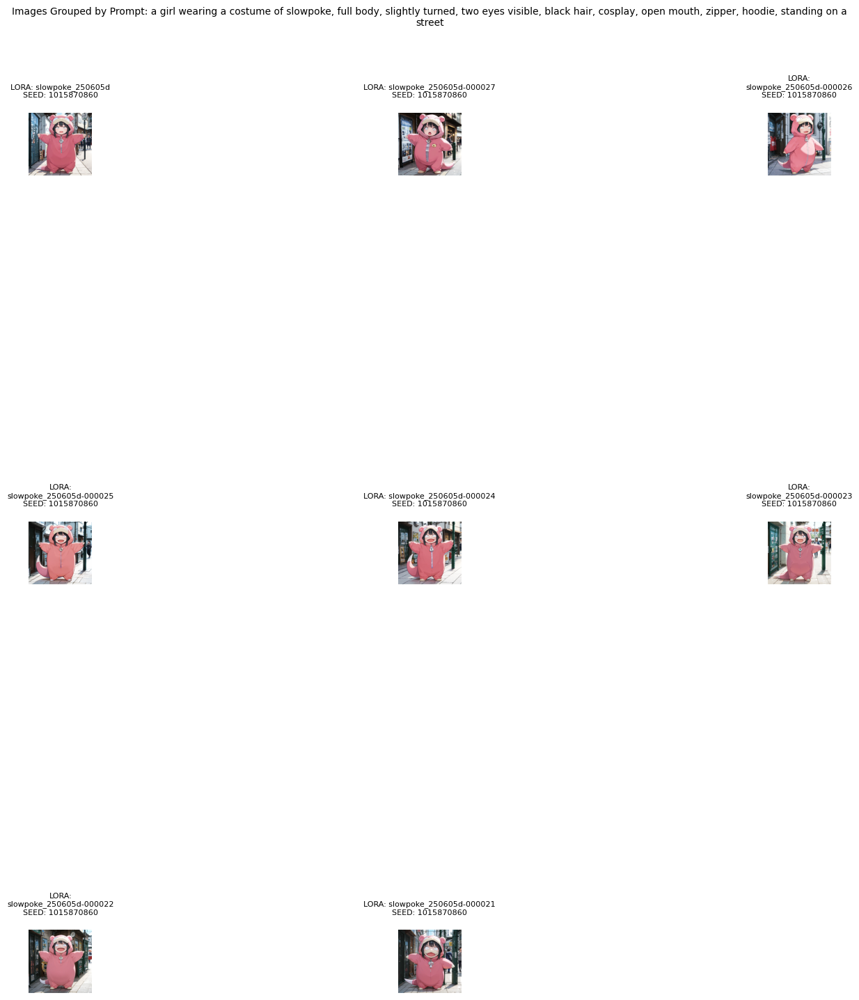

KeyboardInterrupt: 

In [44]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import defaultdict
import math
import re
import textwrap
from metadata_utils import extract_metadata

# Configuration parameters
BASE_LORA = 'slowpoke_250605d'
LORA_LIST = [f'{BASE_LORA}-0000{i:02}' for i in range(21, 28)] + [BASE_LORA]
IMAGE_FOLDER_LIST = [r'S:\webui_forge_cu121_torch231\webui\outputs\txt2img-images\2025-06-04']
IMAGE_SIZE = (4, 4)  # (width, height) in inches for each image
COLUMNS = 3  # Number of columns in the grid
FONT_SIZE = 8  # Font size for subplot titles (points)
MAIN_TITLE_FONT_SIZE = FONT_SIZE + 2  # Font size for main title (points)
MAIN_TITLE_Y_POS = 1.05  # Base vertical position for main title
SUBPLOT_SPACING = 1  # Spacing between subplots (horizontal and vertical)
TITLE_PAD = 0.2  # Padding for subplot titles (inches)
TITLE_PARAMS = ('lora', 'seed')  # Metadata fields to include in subplot titles
DPI = 100  # Resolution for rendering (dots per inch)

# Valid metadata fields for TITLE_PARAMS
VALID_TITLE_PARAMS = (
    'image', 'lora', 'full_original_prompt', 'negative_prompt', 'steps',
    'sampler', 'schedule_type', 'cfg', 'seed', 'img_size', 'model', 'path'
)

# Helper functions
def prompt_symbol_replace(prompt):
    """Replace special characters in prompts with a placeholder."""
    return re.sub(r'<.*?>', '�', prompt).strip()

def convert_prompt_wo_lora(prompt_symbol):
    """Remove placeholder characters from prompts."""
    return prompt_symbol.replace('�', '').strip()

def setup_title(image_info, title_parameters):
    """Generate subplot title from specified metadata parameters."""
    return '\n'.join(f"{param.upper()}: {image_info[param]}" for param in title_parameters)

def collect_images():
    """Collect image metadata for specified LoRA models from given folders."""
    image_to_plot_list = []
    for image_folder in IMAGE_FOLDER_LIST:
        if not os.path.exists(image_folder):
            print(f"Warning: Folder {image_folder} does not exist")
            continue
        for filename in os.listdir(image_folder):
            if filename.endswith(".png"):
                image_path = os.path.join(image_folder, filename)
                try:
                    metadata = extract_metadata(image_path)
                    lora = str(metadata.get('Lora hashes', '')).strip('"').split(':')[0]
                    if lora in LORA_LIST:
                        image_info = {
                            'image': filename,
                            'lora': lora,
                            'full_original_prompt': metadata.get('prompt', ''),
                            'negative_prompt': metadata.get('negative_prompt', ''),
                            'steps': metadata.get('Steps', ''),
                            'sampler': metadata.get('Sampler', ''),
                            'schedule_type': metadata.get('Schedule type', ''),
                            'cfg': metadata.get('CFG scale', ''),
                            'seed': metadata.get('Seed', ''),
                            'img_size': metadata.get('Size', ''),
                            'model': metadata.get('Model', ''),
                            'path': image_path
                        }
                        image_to_plot_list.append(image_info)
                except Exception as e:
                    print(f"Error processing {image_path}: {e}")
    return image_to_plot_list

def plot_images(image_to_plot_list, group_by='prompt'):
    """Plot images grouped by specified parameter with dynamic title sizing."""
    # Validate inputs
    if group_by not in ['prompt', 'seed']:
        raise ValueError("group_by must be 'prompt' or 'seed'")
    invalid_params = [p for p in TITLE_PARAMS if p not in VALID_TITLE_PARAMS]
    if invalid_params:
        raise ValueError(f"Invalid TITLE_PARAMS: {invalid_params}")
    
    # Group images by specified parameter
    grouped_images = defaultdict(list)
    for image_info in image_to_plot_list:
        key = (convert_prompt_wo_lora(prompt_symbol_replace(image_info['full_original_prompt']))
               if group_by == 'prompt' else image_info['seed'])
        grouped_images[key].append(image_info)
    
    # Calculate figure dimensions
    title_line_height = FONT_SIZE / 72.0  # Points to inches (72 points per inch)
    title_height = title_line_height * len(TITLE_PARAMS) + TITLE_PAD
    
    for group_key, images in grouped_images.items():
        num_images = len(images)
        num_rows = math.ceil(num_images / COLUMNS)
        
        # Calculate figure size: image size + title height
        fig_width = COLUMNS * IMAGE_SIZE[0]
        fig_height = num_rows * (IMAGE_SIZE[1] + title_height)
        
        # Create figure with constrained layout
        fig, axes = plt.subplots(num_rows, COLUMNS,
                                figsize=(fig_width, fig_height),
                                layout="constrained",
                                dpi=DPI,
                                gridspec_kw={'wspace': SUBPLOT_SPACING, 'hspace': SUBPLOT_SPACING})
        
        # Handle single row or column cases
        if num_rows == 1:
            axes = [axes] if COLUMNS == 1 else axes
        else:
            axes = axes.flatten()
        
        # Plot images
        for i, image_info in enumerate(images):
            img_path = image_info['path']
            try:
                img = mpimg.imread(img_path)
                axes[i].imshow(img)
                axes[i].axis('off')
                
                # Set subplot title
                title = setup_title(image_info, TITLE_PARAMS)
                axes[i].set_title(title, fontsize=FONT_SIZE, pad=TITLE_PAD * 72, va='bottom', wrap=True)
            except Exception as e:
                print(f"Error loading image {img_path}: {e}")
                axes[i].axis('off')
        
        # Turn off unused axes
        for i in range(num_images, len(axes)):
            axes[i].axis('off')
        
        # Calculate main title width and wrap
        main_title_line_height = MAIN_TITLE_FONT_SIZE / 72.0
        char_width = main_title_line_height / 2  # Approximate character width
        max_chars = int(fig_width / char_width)
        main_title = f"Images Grouped by {group_by.title()}: {group_key}"
        wrapped_title = "\n".join(textwrap.wrap(main_title, width=max_chars))
        main_title_lines = len(wrapped_title.split('\n'))
        
        # Adjust main title position
        main_title_y = MAIN_TITLE_Y_POS + (main_title_lines * main_title_line_height / fig_height)
        
        fig.suptitle(wrapped_title, fontsize=MAIN_TITLE_FONT_SIZE, y=main_title_y)
        
        plt.show()

def main(group_by='prompt'):
    """Main function to collect and plot images."""
    images = collect_images()
    if not images:
        print("No images found matching the criteria")
        return
    plot_images(images, group_by=group_by)

# Run the script
if __name__ == "__main__":
    main(group_by='prompt')
    # To group by seed: main(group_by='seed')